# Model 1: Retina Net(https://arxiv.org/abs/1708.02002v2)

## Imports and Setups


Installing libraries:
 - [fiftyone](https://docs.voxel51.com/api/fiftyone.html)
 - [torch](https://pytorch.org/docs/stable/index.html)
 - [torchvision](https://pytorch.org/vision/stable/index.html)

In [1]:
!pip install fiftyone torch torchvision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 23.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.3/42.3 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 18.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.4/53.4 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.8/57.8 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 13.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.9/108.9 kB 16.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.6/70.6 kB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 677.1/677.1 kB 53.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.3/70.3 kB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 192.5/192.5 kB 25.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.5/88.5 kB 13.6 MB/s eta 0:00:00
  Preparing metadata (set

In [2]:
import torch
import torchvision
from torchvision.transforms import functional as func

import fiftyone as fo
import fiftyone.zoo as foz
from fiftyone import ViewField as F

from PIL import Image

Migrating database to v0.23.2


INFO:fiftyone.migrations.runner:Migrating database to v0.23.2


## Downloading Datasets

1. Downloading [2017 Coco Validation Images](https://docs.voxel51.com/user_guide/dataset_zoo/datasets.html#coco-2017)

In [3]:
coco_val_data = foz.load_zoo_dataset("coco-2017", split="validation")
coco_val_data.persistent = True
coco_classes = coco_val_data.default_classes

INFO:fiftyone.zoo.datasets:Downloading split 'validation' to '/root/fiftyone/coco-2017/validation' if necessary


INFO:fiftyone.utils.coco:Downloading annotations to '/root/fiftyone/coco-2017/tmp-download/annotations_trainval2017.zip'


 100% |██████|    1.9Gb/1.9Gb [3.5s elapsed, 0s remaining, 593.3Mb/s]      


INFO:eta.core.utils: 100% |██████|    1.9Gb/1.9Gb [3.5s elapsed, 0s remaining, 593.3Mb/s]      


Extracting annotations to '/root/fiftyone/coco-2017/raw/instances_val2017.json'


INFO:fiftyone.utils.coco:Extracting annotations to '/root/fiftyone/coco-2017/raw/instances_val2017.json'


INFO:fiftyone.utils.coco:Downloading images to '/root/fiftyone/coco-2017/tmp-download/val2017.zip'


 100% |██████|    6.1Gb/6.1Gb [9.4s elapsed, 0s remaining, 707.0Mb/s]       


INFO:eta.core.utils: 100% |██████|    6.1Gb/6.1Gb [9.4s elapsed, 0s remaining, 707.0Mb/s]       


Extracting images to '/root/fiftyone/coco-2017/validation/data'


INFO:fiftyone.utils.coco:Extracting images to '/root/fiftyone/coco-2017/validation/data'


Writing annotations to '/root/fiftyone/coco-2017/validation/labels.json'


INFO:fiftyone.utils.coco:Writing annotations to '/root/fiftyone/coco-2017/validation/labels.json'


Dataset info written to '/root/fiftyone/coco-2017/info.json'


INFO:fiftyone.zoo.datasets:Dataset info written to '/root/fiftyone/coco-2017/info.json'


Loading 'coco-2017' split 'validation'


INFO:fiftyone.zoo.datasets:Loading 'coco-2017' split 'validation'


 100% |███████████████| 5000/5000 [32.3s elapsed, 0s remaining, 197.4 samples/s]      


INFO:eta.core.utils: 100% |███████████████| 5000/5000 [32.3s elapsed, 0s remaining, 197.4 samples/s]      


Dataset 'coco-2017-validation' created


INFO:fiftyone.zoo.datasets:Dataset 'coco-2017-validation' created


Getting information about 2017 Coco validation images:

In [4]:
print(coco_val_data)

Name:        coco-2017-validation
Media type:  image
Num samples: 5000
Persistent:  True
Tags:        []
Sample fields:
    id:           fiftyone.core.fields.ObjectIdField
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)


2. Downloading [Pascal Validation Images](https://docs.voxel51.com/user_guide/dataset_zoo/datasets.html#dataset-zoo-voc-2007)

In [5]:
pascal_val_data = foz.load_zoo_dataset("voc-2012", split="validation")
pascal_val_data.persistent = True

INFO:fiftyone.zoo.datasets:Downloading split 'validation' to '/root/fiftyone/voc-2012/validation'


100%|██████████| 1999639040/1999639040 [01:06<00:00, 30149490.96it/s]


Extracting /root/fiftyone/voc-2012/tmp-download/VOCtrainval_11-May-2012.tar to /root/fiftyone/voc-2012/tmp-download
 100% |███████████████| 5823/5823 [1.5m elapsed, 0s remaining, 84.0 samples/s]      


INFO:eta.core.utils: 100% |███████████████| 5823/5823 [1.5m elapsed, 0s remaining, 84.0 samples/s]      


Dataset info written to '/root/fiftyone/voc-2012/info.json'


INFO:fiftyone.zoo.datasets:Dataset info written to '/root/fiftyone/voc-2012/info.json'


Loading 'voc-2012' split 'validation'


INFO:fiftyone.zoo.datasets:Loading 'voc-2012' split 'validation'


 100% |███████████████| 5823/5823 [17.7s elapsed, 0s remaining, 281.9 samples/s]      


INFO:eta.core.utils: 100% |███████████████| 5823/5823 [17.7s elapsed, 0s remaining, 281.9 samples/s]      


Dataset 'voc-2012-validation' created


INFO:fiftyone.zoo.datasets:Dataset 'voc-2012-validation' created


A dictionary that fixes the labels of Pascal

In [6]:
alt_classes = {
    "airplane" : "aeroplane",
    "motorcycle" : "motorbike",
    "dining table" : "diningtable",
    "potted plant" : "pottedplant",
    "couch" : "sofa",
    "tv" : "tvmonitor",
    "bicycle" : "bicycle"
}

Getting information about 2007 Pascal Validation Images:

In [7]:
print(pascal_val_data)

Name:        voc-2012-validation
Media type:  image
Num samples: 5823
Persistent:  True
Tags:        []
Sample fields:
    id:           fiftyone.core.fields.ObjectIdField
    filepath:     fiftyone.core.fields.StringField
    tags:         fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    ground_truth: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)


## Loading Model

In [21]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

model = torchvision.models.detection.retinanet_resnet50_fpn(pretrained=True)

model.to(device)

model_name = "retinanet"

model.eval()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=RetinaNet_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=RetinaNet_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


RetinaNet(
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(256, eps=0.0)


In [22]:
layer1 = [model.backbone.body.conv1,
          model.backbone.body.layer1[0].conv1,
          model.backbone.body.layer1[0].bn1,
          model.backbone.body.layer1[0].conv2,
          model.backbone.body.layer1[0].bn2,
          model.backbone.body.layer1[0].conv3,
          model.backbone.body.layer1[0].bn3,
          model.backbone.body.layer1[0].downsample[0],
          model.backbone.body.layer1[0].downsample[1]]

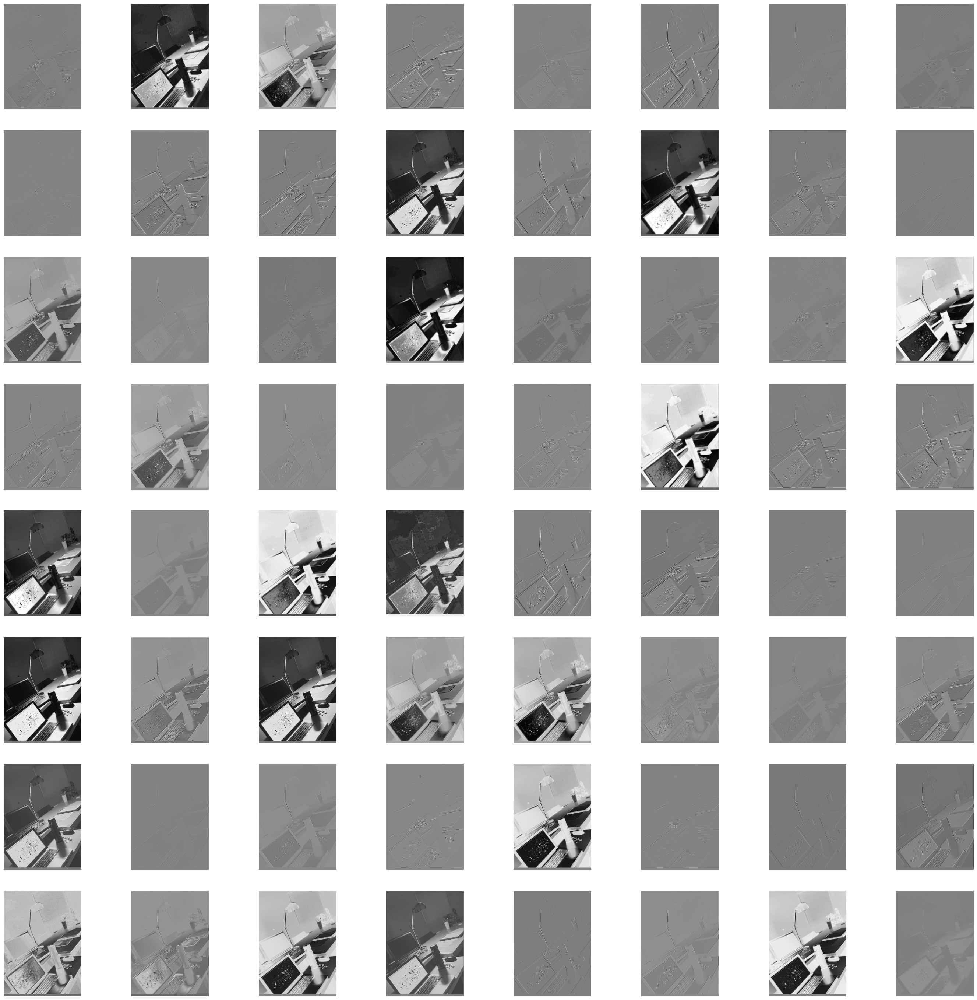

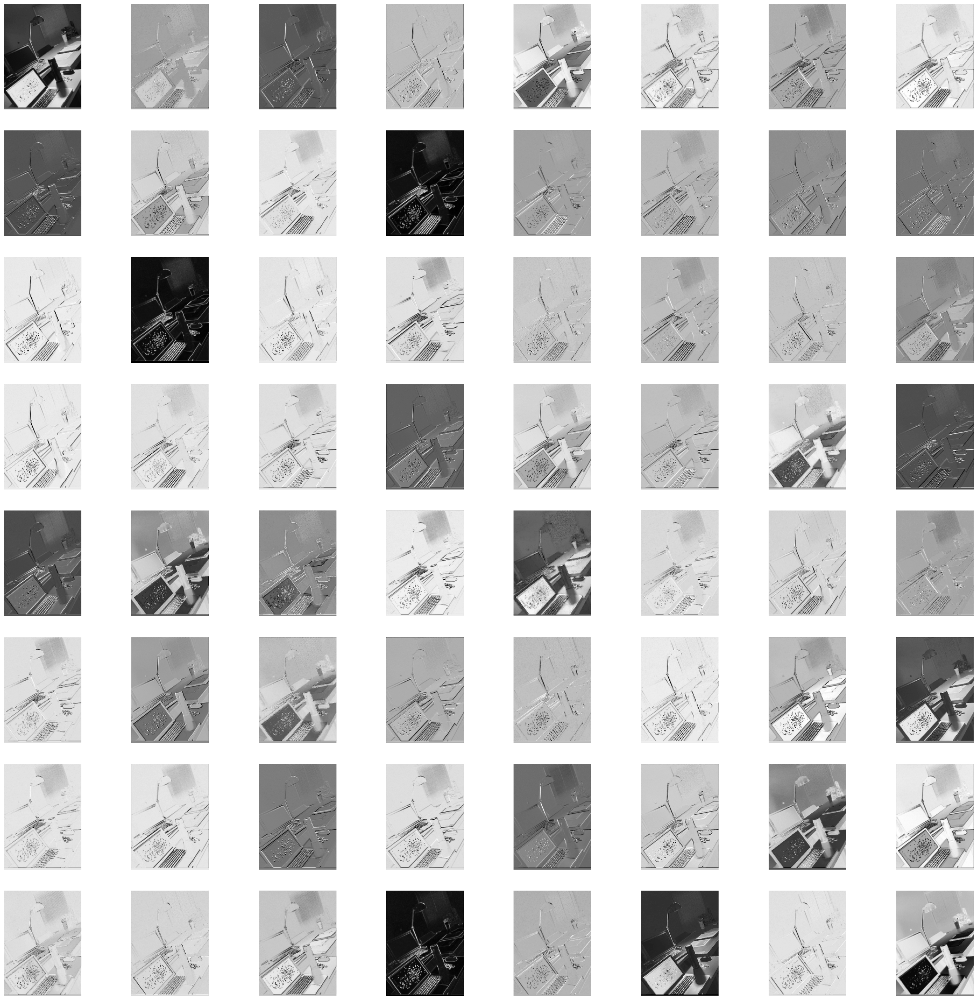

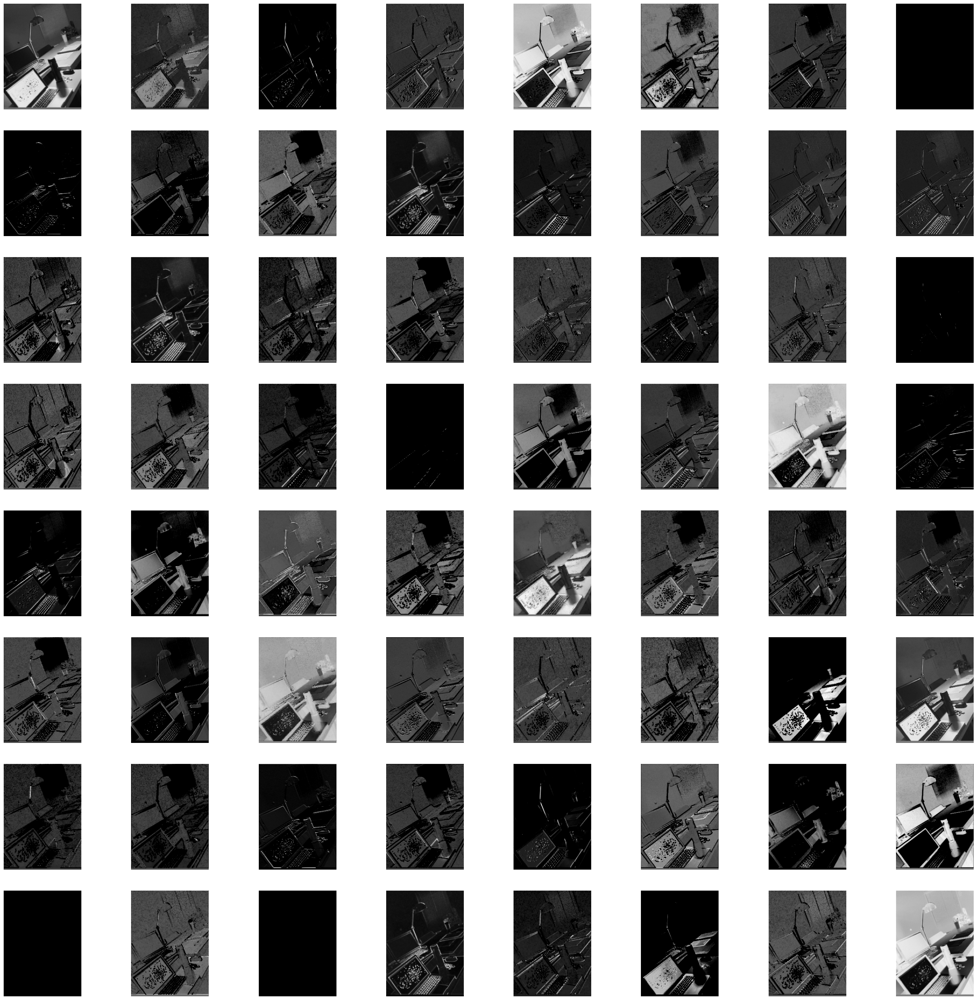

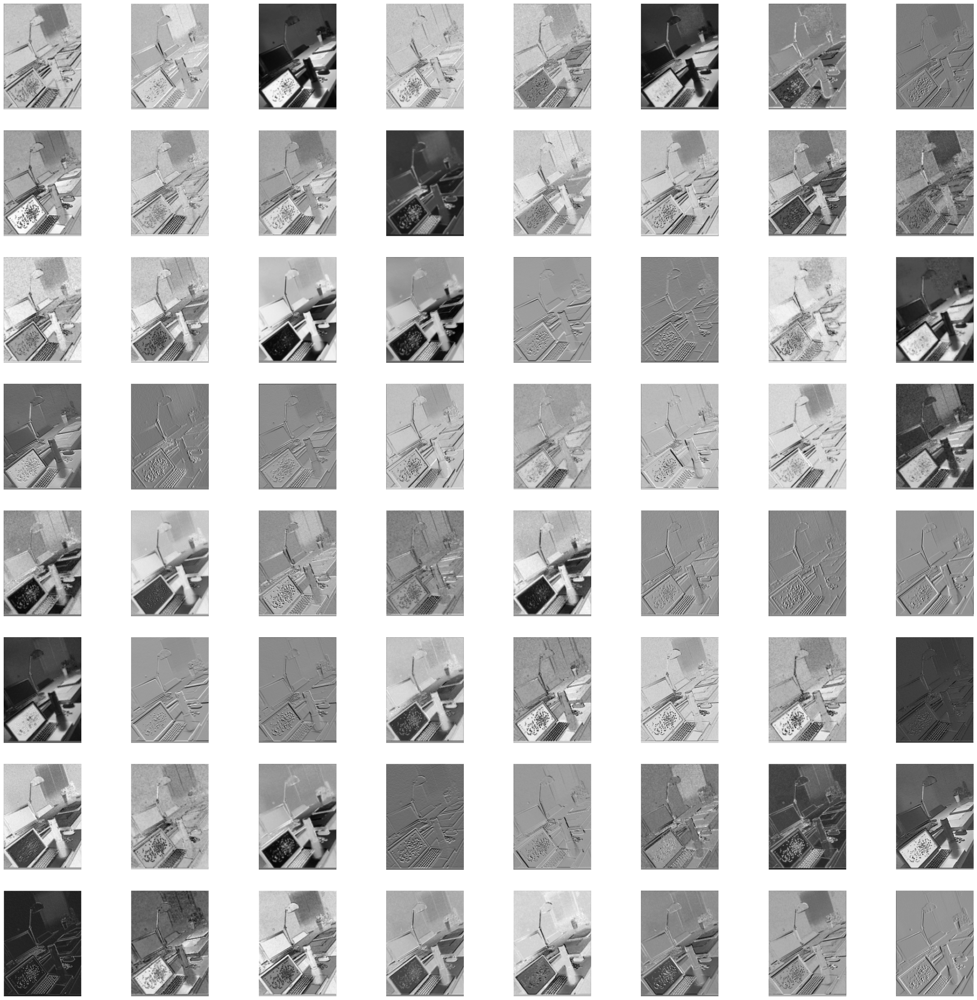

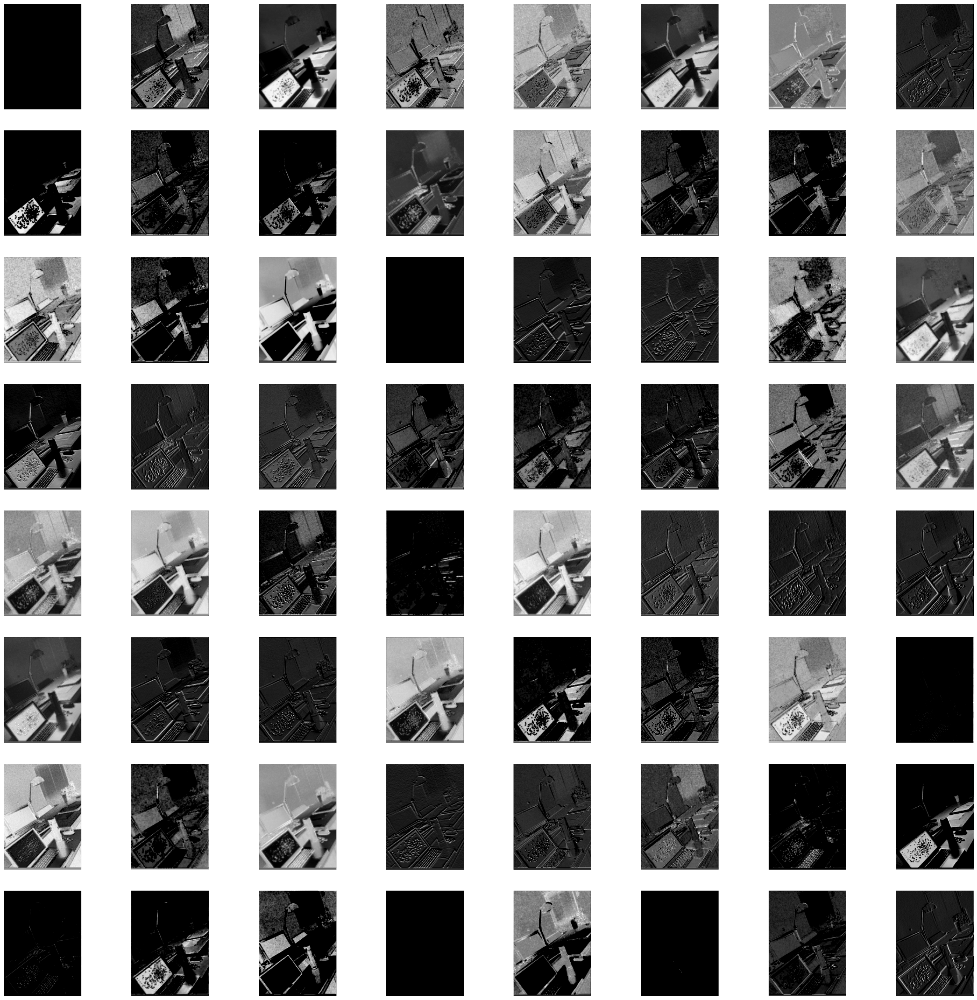

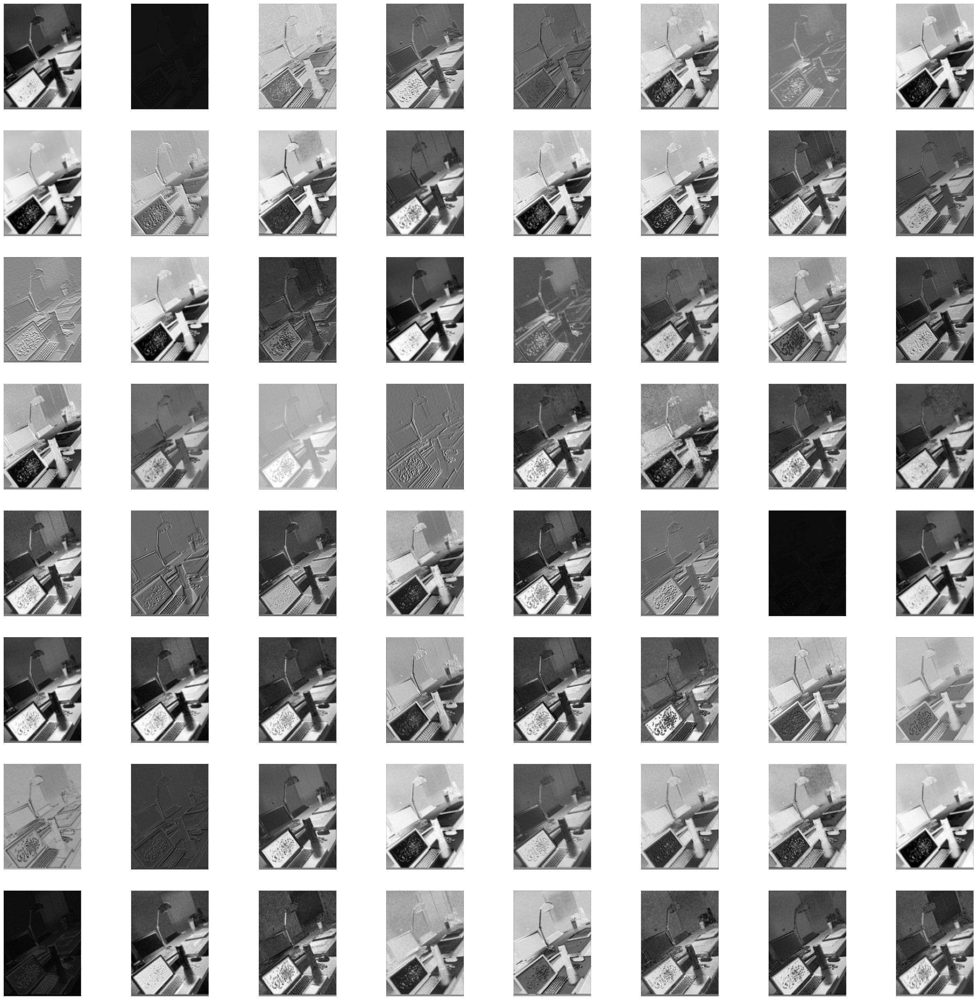

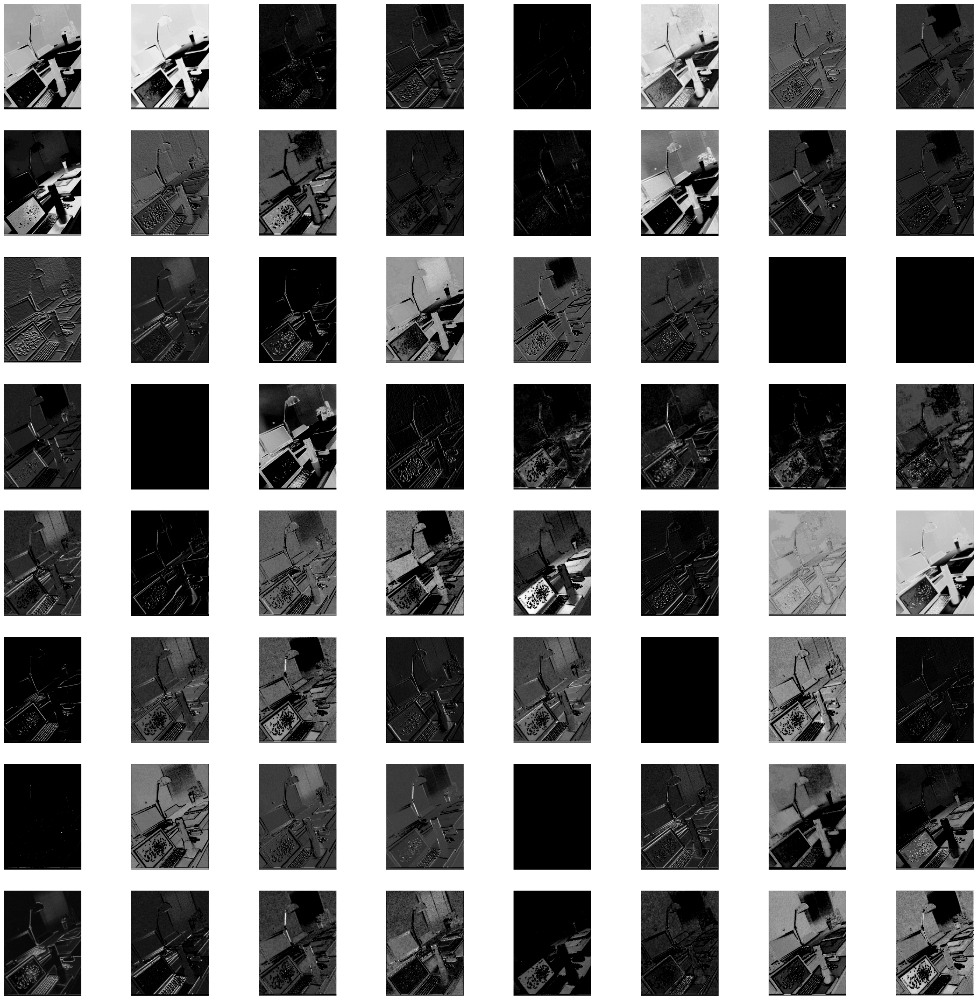

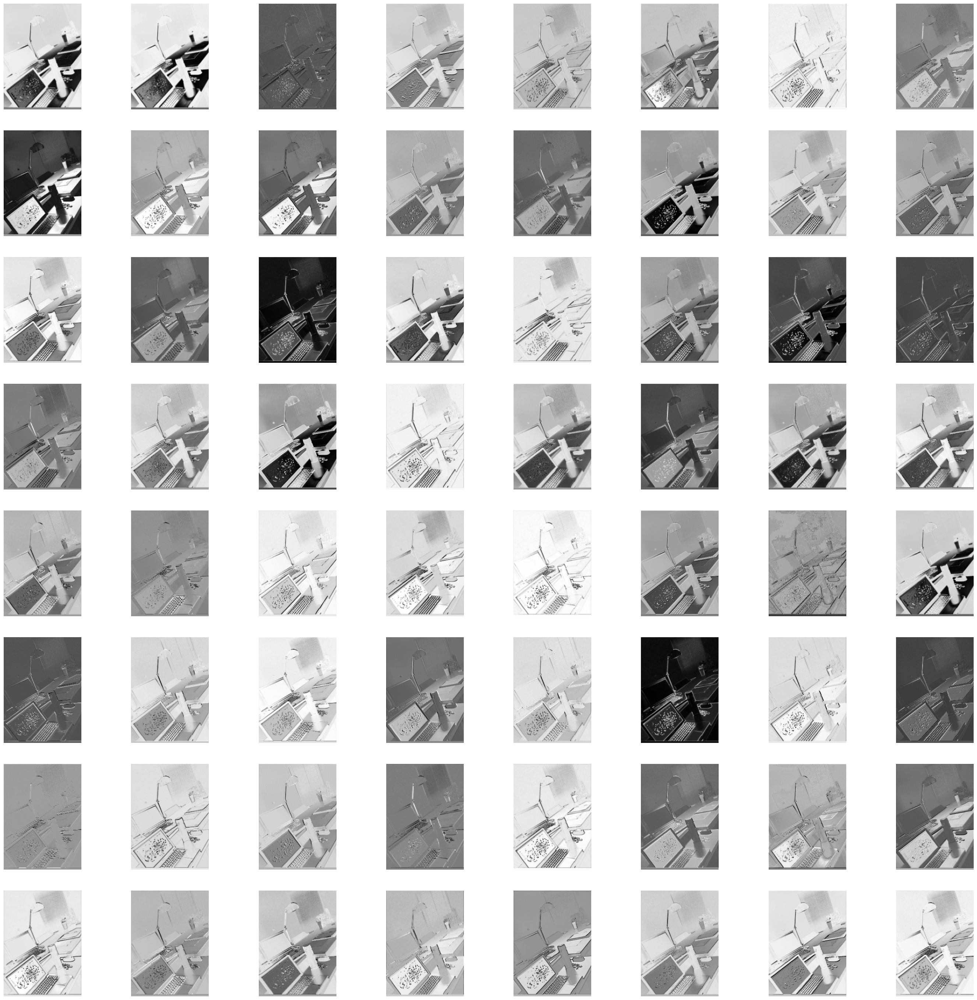

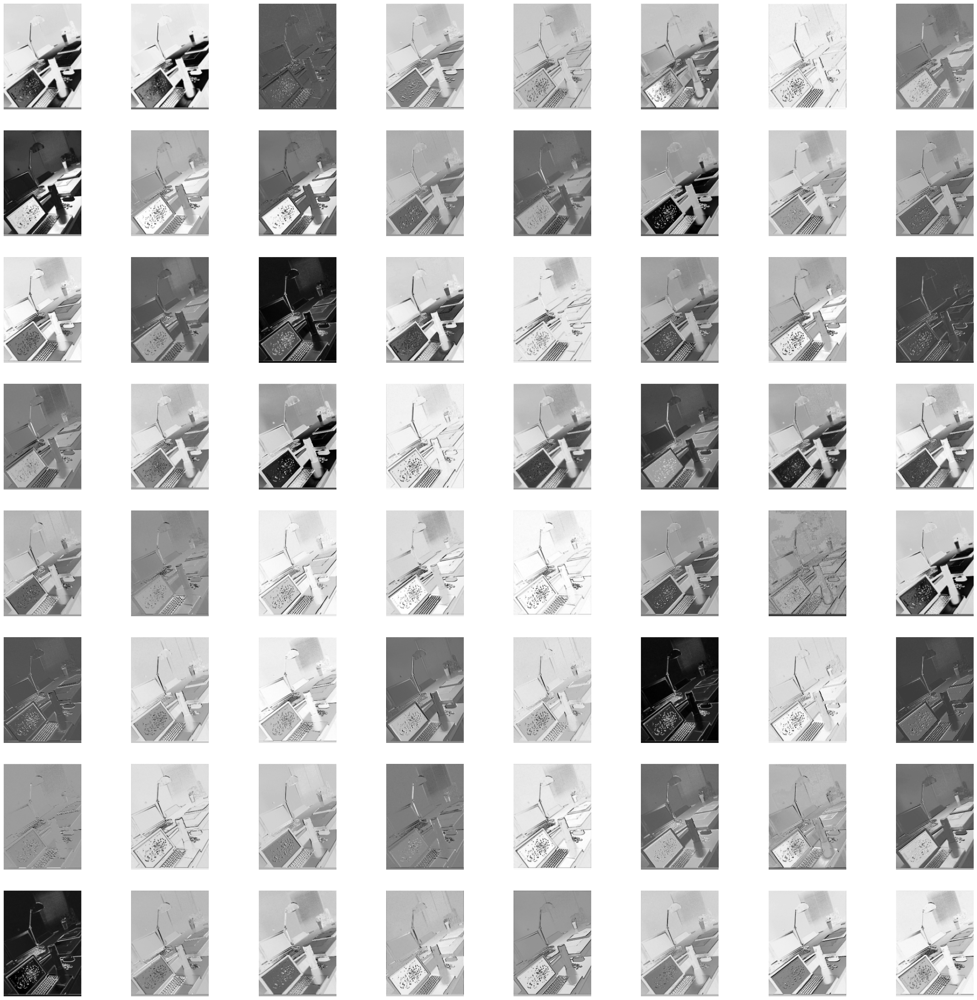

In [23]:
layer1_outputs = []

def layer1_hook(module, input, output):
    layer1_outputs.append(output)

for layer in layer1:
  layer.register_forward_hook(layer1_hook)

image = Image.open(coco_val_data.take(1, seed=6).first().filepath)
image = func.to_tensor(image).to(device)
pred = model([image])

for num_layer in range(len(layer1_outputs)):
    plt.figure(figsize=(35, 35))
    layer_viz = layer1_outputs[num_layer][0, :, :, :].data

    for i, filter in enumerate(layer_viz):
        if i == 64:
            break
        filter_cpu = filter.cpu()
        plt.subplot(8, 8, i + 1)
        plt.imshow(filter_cpu, cmap='gray')
        plt.axis("off")
        del filter_cpu
        gc.collect()
    plt.show()

# Coco Dataset

## Model Inference

In [9]:
def add_predictions(model, model_name, classes, predictions_view, alt_classes):
  # Add predictions to samples
  with fo.ProgressBar() as pb:
      for sample in pb(predictions_view):
          # Load image
          image = Image.open(sample.filepath)
          image = func.to_tensor(image).to(device)
          c, h, w = image.shape

          # Perform inference
          preds = model([image])[0]
          labels = preds["labels"].cpu().detach().numpy()
          scores = preds["scores"].cpu().detach().numpy()
          boxes = preds["boxes"].cpu().detach().numpy()

          # Convert detections to FiftyOne format
          detections = []
          for label, score, box in zip(labels, scores, boxes):
              # Convert to [top-left-x, top-left-y, width, height]
              # in relative coordinates in [0, 1] x [0, 1]
              x1, y1, x2, y2 = box

              rel_box = [x1 / w, y1 / h, (x2 - x1) / w, (y2 - y1) / h]

              detections.append(
                  fo.Detection(
                      label=alt_classes[classes[label]] if classes[label] in alt_classes else classes[label],
                      bounding_box=rel_box,
                      confidence=score
                  )
              )

          # Save predictions to dataset
          sample[model_name] = fo.Detections(detections=detections)
          sample.save()

In [10]:
coco_predictions_view = coco_val_data.take(500, seed=51)

add_predictions(model, model_name, coco_classes, coco_predictions_view, alt_classes)

 100% |█████████████████| 500/500 [1.6m elapsed, 0s remaining, 4.9 samples/s]      


INFO:eta.core.utils: 100% |█████████████████| 500/500 [1.6m elapsed, 0s remaining, 4.9 samples/s]      


In [12]:
session = fo.launch_app(coco_predictions_view)


Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v0.23.2

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Slack community 🚀🚀🚀
|  https://slack.voxel51.com
|



INFO:fiftyone.core.session.session:
Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v0.23.2

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Slack community 🚀🚀🚀
|  https://slack.voxel51.com
|



In [13]:
session.freeze()  # fixes the session (like a screenshot of the session)

## Evaluation

In [14]:
def compute_mAP(predictions_view, model_name, confidence, iou_threshold):
  high_conf_view = predictions_view.filter_labels(model_name, F("confidence") > confidence, only_matches=False)

  results = high_conf_view.evaluate_detections(
    model_name,
    gt_field="ground_truth",
    eval_key="eval",
    compute_mAP=True,
    iou=iou_threshold
  )

  return results.mAP()

In [15]:
def compute_mean_iou(predictions_view, confidence):
  high_conf_view = predictions_view.filter_labels(model_name, F("confidence") > confidence, only_matches=False)

  count = 0
  sum = 0.0

  with fo.ProgressBar() as pb:
      for sample in pb(high_conf_view.iter_samples()):
          for detection in sample[model_name].detections:
              if detection.eval == 'tp':
                  sum += detection.eval_iou
                  count += 1

  if count > 0:
    return sum / count

  return None

In [16]:
coco_mAP = compute_mAP(coco_predictions_view, model_name, 0.2, 0.5)
coco_mean_iou = compute_mean_iou(coco_predictions_view, 0.2)

Evaluating detections...


INFO:fiftyone.utils.eval.detection:Evaluating detections...


 100% |█████████████████| 500/500 [1.2m elapsed, 0s remaining, 9.9 samples/s]        


INFO:eta.core.utils: 100% |█████████████████| 500/500 [1.2m elapsed, 0s remaining, 9.9 samples/s]        


Performing IoU sweep...


INFO:fiftyone.utils.eval.coco:Performing IoU sweep...


 100% |█████████████████| 500/500 [19.4s elapsed, 0s remaining, 14.8 samples/s]      


INFO:eta.core.utils: 100% |█████████████████| 500/500 [19.4s elapsed, 0s remaining, 14.8 samples/s]      


 500 [4.7s elapsed, 97.5 samples/s]    


INFO:eta.core.utils: 500 [4.7s elapsed, 97.5 samples/s]    


In [17]:
print(f'mAP using coco: {coco_mAP}')
print(f'mean IoU using coco: {coco_mean_iou}')

mAP using coco: 0.3569419349900375
mean IoU using coco: 0.8734304333532029


In [18]:
def filter_detections(predictions_view, confidence, eval):
  high_conf_view = predictions_view.filter_labels(model_name, F("confidence") > confidence, only_matches=False)

  return high_conf_view.sort_by(eval, reverse=True)

Best predictions according to TP with confidence: 0.5

In [19]:
session.view = filter_detections(coco_predictions_view, 0.5, "eval_tp")

In [20]:
session.freeze()  # fixes the session (like a screenshot of the session)

Worst predictions according to FP with confidence: 0.5

In [21]:
session.view = filter_detections(coco_predictions_view, 0.5, "eval_fp")

In [22]:
session.freeze()  # fixes the session (like a screenshot of the session)

# Pascal Dataset

## Model Inference

In [23]:
pascal_predictions_view = pascal_val_data.take(500, seed=51)

add_predictions(model, model_name, coco_classes, pascal_predictions_view, alt_classes)

 100% |█████████████████| 500/500 [1.5m elapsed, 0s remaining, 6.4 samples/s]      


INFO:eta.core.utils: 100% |█████████████████| 500/500 [1.5m elapsed, 0s remaining, 6.4 samples/s]      


In [24]:
session = fo.launch_app(pascal_predictions_view)

In [25]:
session.freeze()  # fixes the session (like a screenshot of the session)

## Evaluation

In [26]:
pascal_mAP = compute_mAP(pascal_predictions_view, model_name, 0.2, 0.5)
pascal_mean_iou = compute_mean_iou(pascal_predictions_view, 0.2)

Evaluating detections...


INFO:fiftyone.utils.eval.detection:Evaluating detections...


 100% |█████████████████| 500/500 [23.7s elapsed, 0s remaining, 23.0 samples/s]      


INFO:eta.core.utils: 100% |█████████████████| 500/500 [23.7s elapsed, 0s remaining, 23.0 samples/s]      


Performing IoU sweep...


INFO:fiftyone.utils.eval.coco:Performing IoU sweep...


 100% |█████████████████| 500/500 [7.9s elapsed, 0s remaining, 79.4 samples/s]       


INFO:eta.core.utils: 100% |█████████████████| 500/500 [7.9s elapsed, 0s remaining, 79.4 samples/s]       


 500 [2.4s elapsed, 208.0 samples/s]    


INFO:eta.core.utils: 500 [2.4s elapsed, 208.0 samples/s]    


In [27]:
print(f'mAP using pascal: {pascal_mAP}')
print(f'mean IoU using pascal: {pascal_mean_iou}')

mAP using pascal: 0.5543207498396685
mean IoU using pascal: 0.8290647115841172


Best predictions according to TP with confidence: 0.5

In [28]:
session.view = filter_detections(pascal_predictions_view, 0.5, "eval_tp")

In [29]:
session.freeze()  # fixes the session (like a screenshot of the session)

Worst predictions according to FP with confidence: 0.5

In [31]:
session.view = filter_detections(pascal_predictions_view, 0.5, "eval_fn")